In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

In [3]:
from PIL import Image
from IPython.display import display

import os
import numpy as np
import matplotlib.pyplot as plt
import pickle

import tensorflow as tf
from tensorflow.keras import layers, models

from get_frames import get_frames
from build_model_ed import build_model_1, build_model_2
from create_encoder_decoder_data import process_image, process_dataset, get_full_path
from get_encoder_decoder import get_encoder_decoder

In [4]:
#gpu check
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  2


In [5]:
#load data
test_size = 0.1
stride_step = 160
norm_factor=1
dtype = 'uint8'

In [6]:
stride_step_load = 50
filename = f'save_data/e_d_train_all_str_{stride_step_load}_ts_{test_size}_{dtype}_norm_{norm_factor}.pkl'
#filename = f'save_data/e_d_train_Puck_str_{stride_step}_ts_{test_size}_{dtype}_norm_{norm_factor}.pkl'
#filename = f'save_data/e_d_test_Puck_str_{stride_step}_ts_{test_size}_{dtype}_norm_{norm_factor}.pkl'


#load data
with open(filename, 'rb') as f:
    image_list,frames_data = pickle.load(f)

del frames_data 

In [7]:
len(image_list)

77

In [8]:
#create dataset
angle_settings_list = [-6,6,3]
ifFlip=True
dtype = 'uint8'
norm_factor = 1
crop_horizontal = 96
ifPrint = True

#image_list = image_list[:10]

folder_list = ['PuckerImages//RGB_cropped',
             'TwistImages//RGB',
             'FoldImages//RGB',]

file_path_list = get_full_path(image_list, folder_list)

angle_min, angle_max, angle_step = angle_settings_list
angle_list = np.arange(angle_min, 1.1*angle_max, angle_step)

print(f'Angle list for data augmentation: {angle_list}')
print(f'Images in the dataset: {image_list}\n')

frames_data = process_dataset(
    file_path_list,
    stride_step,
    angle_list,
    crop_horizontal,
    ifFlip = ifFlip,
    dtype = dtype,
    norm_factor=norm_factor,
    ifPrint=ifPrint
)


print(f'\nDataset shape: {frames_data.shape}')

Angle list for data augmentation: [-6. -3.  0.  3.  6.]
Images in the dataset: ['Fold1.png', 'Twist17.png', 'Fold18.png', 'Twist20.png', 'Fold14.png', 'Twist26.png', 'Fold8.png', 'Twist21.png', 'Fold10.png', 'Twist14.png', 'Fold22.png', 'Pucker9.png', 'Pucker21.png', 'Twist25.png', 'Pucker5.png', 'Pucker4.png', 'Fold17.png', 'Pucker32.png', 'Twist27.png', 'Pucker30.png', 'Twist28.png', 'Twist7.png', 'Twist18.png', 'Pucker28.png', 'Twist16.png', 'Twist1.png', 'Pucker11.png', 'Twist32.png', 'Fold15.png', 'Pucker15.png', 'Fold4.png', 'Pucker13.png', 'Twist30.png', 'Pucker2.png', 'Pucker12.png', 'Pucker22.png', 'Pucker14.png', 'Twist8.png', 'Pucker20.png', 'Fold7.png', 'Pucker6.png', 'Twist12.png', 'Twist5.png', 'Fold11.png', 'Fold5.png', 'Twist23.png', 'Twist11.png', 'Twist13.png', 'Fold19.png', 'Pucker10.png', 'Fold2.png', 'Pucker8.png', 'Twist9.png', 'Twist6.png', 'Pucker18.png', 'Twist29.png', 'Fold13.png', 'Twist24.png', 'Twist4.png', 'Fold12.png', 'Twist15.png', 'Twist19.png', 'Fold6

In [8]:
#load encoder-decoder model
units_numb = 10
model_name = f'model_ed_2_ps_2_bn_True_du_{units_numb}'
#model_name = 'model_ed_1_ps_2_bn_True_du_100'
loss = 'mean_squared_error'
optimizer = tf.keras.optimizers.legacy.Adadelta(learning_rate=0.1, name="Adadelta")
#optimizer = tf.keras.optimizers.Adadelta(learning_rate=0.01, name="SGD")
ifEncoder=True
ifDecoder=True
ifSummary=True


#input_shape = frames_data.shape[1:]
input_shape = (2048, stride_step, 3)

filename = f'saved_models/stride_{stride_step}/{model_name}_settings.pkl'
#load nn settings
with open(filename, 'rb') as f:
    dense_units,ifBatchNorm,kernel_size,nn_blocks = pickle.load(f)
model_settings = (input_shape, dense_units,ifBatchNorm,kernel_size,nn_blocks)
model_weights_path = f'saved_models/stride_{stride_step}/{model_name}/{model_name}'

model_list = get_encoder_decoder(
    model_name, 
    model_weights_path, 
    model_settings, 
    loss, optimizer, 
    ifEncoder=ifEncoder, 
    ifDecoder=ifDecoder, 
    ifSummary=ifSummary
)


#####Main model model#####

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 2048, 160, 3)]    0         
                                                                 
 rescaling (Rescaling)       (None, 2048, 160, 3)      0         
                                                                 
 conv2d (Conv2D)             (None, 2048, 160, 4)      112       
                                                                 
 batch_normalization (BatchN  (None, 2048, 160, 4)     16        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 1024, 160, 4)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (No

 up_sampling2d_5 (UpSampling  (None, 512, 160, 16)     0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 512, 160, 8)       1160      
                                                                 
 batch_normalization_14 (Bat  (None, 512, 160, 8)      32        
 chNormalization)                                                
                                                                 
 up_sampling2d_6 (UpSampling  (None, 1024, 160, 8)     0         
 2D)                                                             
                                                                 
 conv2d_15 (Conv2D)          (None, 1024, 160, 4)      292       
                                                                 
 batch_normalization_15 (Bat  (None, 1024, 160, 4)     16        
 chNormalization)                                                
          

 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 32, 160, 100)      108100    
                                                                 
 batch_normalization_10 (Bat  (None, 32, 160, 100)     400       
 chNormalization)                                                
                                                                 
 up_sampling2d_2 (UpSampling  (None, 64, 160, 100)     0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 64, 160, 64)       57664     
                                                                 
 batch_normalization_11 (Bat  (None, 64, 160, 64)      256       
 chNormalization)                                                
                                                                 
 up_sampli

In [8]:
#saving models
model_list[1].save('saved_models/my_model_test')

INFO:tensorflow:Assets written to: saved_models/my_model_test/assets


INFO:tensorflow:Assets written to: saved_models/my_model_test/assets


In [9]:
file_name = f'save_data//encoded_model_2//frame_data_original_{stride_step}.pkl'
with open(file_name, 'wb') as f:
    pickle.dump(frames_data, f)

In [9]:
file_name = f'save_data//encoded_model_2//frame_data_original_{stride_step}.pkl'
with open(file_name, 'rb') as f:
    frames_data = pickle.load(f)

In [10]:
#encode data
model_encoder = model_list[0]
frames_data_encoded = model_encoder.predict(frames_data)
print(f'Original (input) data shape: {frames_data.shape}')
print(f'Encoded data shape: {frames_data_encoded.shape}')

602/602 [==============================] - 22s 34ms/step
Original (input) data shape: (19250, 2048, 160, 3)
Encoded data shape: (19250, 10)


In [11]:
#reshape and save
#reshape from
#[frames,height,width,channels]
#to
#[image,frames,height,width,channels]

angle_settings_list = [-6,6,3]
ifFlip=True
dtype = 'uint8'
norm_factor = 1

angle_min, angle_max, angle_step = angle_settings_list
angle_list = np.arange(angle_min, 1.1*angle_max, angle_step)


data_shape = frames_data_encoded.shape
print(f'Current data shape: {data_shape}')
#number of images
if ifFlip:
    img_nmb = len(image_list)*len(angle_list)*2
else:
    img_nmb = len(image_list)*len(angle_list)
new_data_shape = (img_nmb, data_shape[0]//img_nmb, data_shape[1])
print(f'New data shape: {new_data_shape}')

if 1:
    #save data
    file_name = f'save_data//encoded_model_2//encoded_{units_numb}_{stride_step}_ts_{test_size}_{dtype}_norm_{norm_factor}.pkl'
    with open(file_name, 'wb') as f:
        pickle.dump(frames_data_encoded.reshape(new_data_shape), f)

Current data shape: (19250, 10)
New data shape: (770, 25, 10)


In [9]:
#load data
test_size = 0.1
stride_step = 50
norm_factor=1
dtype = 'uint8'

file_name = f'save_data//encoded_train_temp_{stride_step}_ts_{test_size}_{dtype}_norm_{norm_factor}.pkl'
with open(file_name, 'rb') as f:
    frames_data_encoded = pickle.load(f)
    
print(f'Data shape: {frames_data_encoded.shape}')

if 0:
    frames_data_encoded = frames_data_encoded.reshape(frames_data_encoded.shape[0]*frames_data_encoded.shape[1], frames_data_encoded.shape[2])
    print(f'Data shape: {frames_data_encoded.shape}')

Data shape: (280, 80, 100)


In [11]:
#check decoding for the whole dataset
#because the output is float and not int, raises ResourceExhaustedError 
model_decoder = models.load_model('saved_models/my_model_test')
#model_decoder = model_list[1]

frames_data_decoded = model_decoder.predict(frames_data_encoded)
print(f'Decoded data shape: {frames_data_decoded.shape}')

200/200 [==============================] - 3s 10ms/step


ResourceExhaustedError: {{function_node __wrapped__ConcatV2_N_200_device_/job:localhost/replica:0/task:0/device:GPU:0}} OOM when allocating tensor with shape[6400,2048,50,3] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc [Op:ConcatV2] name: concat

In [15]:
#check decoding for just one image in the shifted dataset
#image index
img_ind = 211

#create dataset for lstm
x_train_lstm = frames_data_encoded[:,:-1,:]
y_train_lstm = frames_data_encoded[:,1:,:]
print(f'x_train_lstm: {x_train_lstm.shape}')
print(f'y_train_lstm: {y_train_lstm.shape}')

if 1:
    x_train_lstm = x_train_lstm[img_ind]
    y_train_lstm = y_train_lstm[img_ind]
else:
    x_train_lstm.reshape(x_train_lstm.shape[0]*x_train_lstm.shape[1], x_train_lstm.shape[2])
    y_train_lstm.reshape(y_train_lstm.shape[0]*y_train_lstm.shape[1], y_train_lstm.shape[2])


model_decoder = models.load_model('saved_models/my_model_test')
#model_decoder = model_list[1]

x_train_lstm_decoded = model_decoder.predict(x_train_lstm)
print(f'Decoded data shape: {x_train_lstm_decoded.shape}')
y_train_lstm_decoded = model_decoder.predict(y_train_lstm)
print(f'Decoded data shape: {y_train_lstm_decoded.shape}')

x_train_lstm: (280, 79, 100)
y_train_lstm: (280, 79, 100)
3/3 [==============================] - 0s 10ms/step
Decoded data shape: (79, 2048, 50, 3)
3/3 [==============================] - 0s 10ms/step
Decoded data shape: (79, 2048, 50, 3)


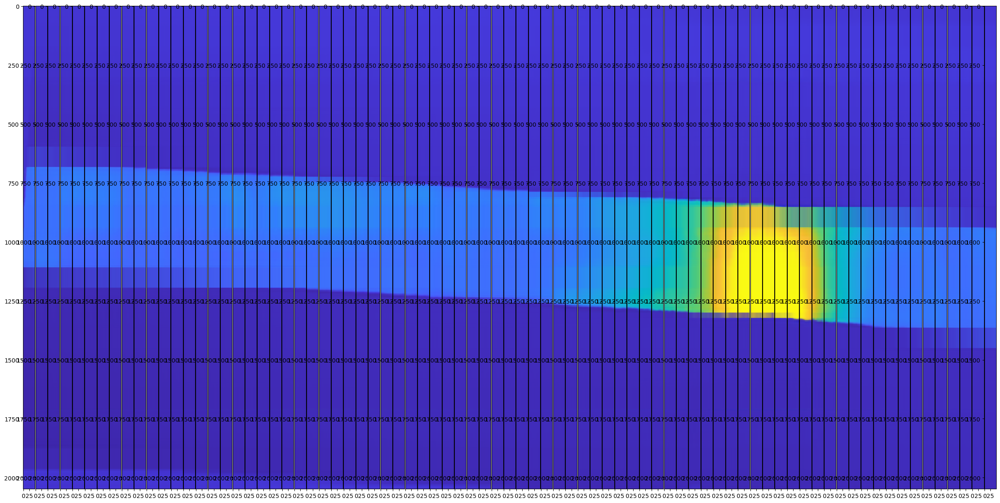

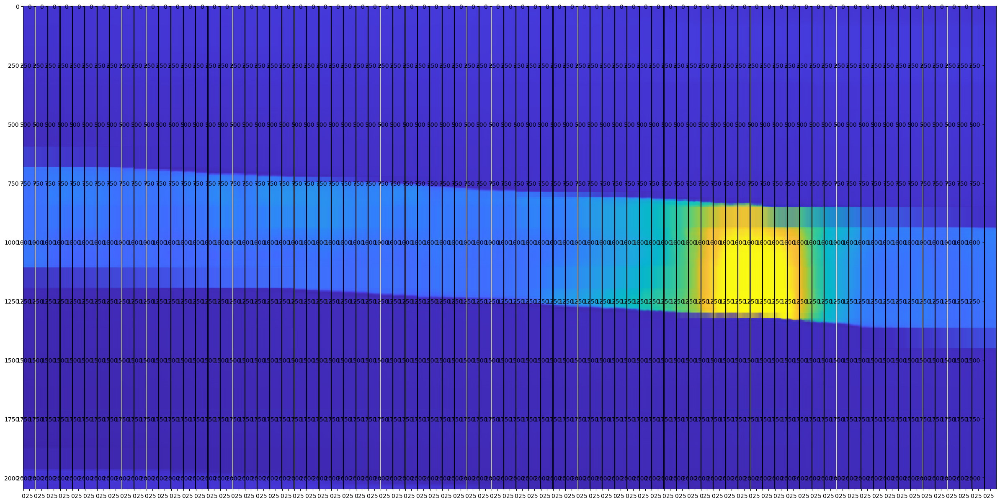

In [16]:
#plot shifted decoded images

numb_col = x_train_lstm_decoded.shape[0]               
fig, axes = plt.subplots(1,numb_col, figsize=(30,15))
fig.subplots_adjust(hspace=0.2, wspace=0)
linewidth = 3.0
fontsize_sec = 12
for i,frame in enumerate(x_train_lstm_decoded):
    ax = axes[i]
    ax.imshow(frame.astype(int))
    
numb_col = y_train_lstm_decoded.shape[0]               
fig, axes = plt.subplots(1,numb_col, figsize=(30,15))
fig.subplots_adjust(hspace=0.2, wspace=0)
linewidth = 3.0
fontsize_sec = 12
for i,frame in enumerate(y_train_lstm_decoded):
    ax = axes[i]
    ax.imshow(frame.astype(int))

Current data shape: (8000, 2048, 50, 3)
New data shape: (100, 80, 2048, 50, 3)


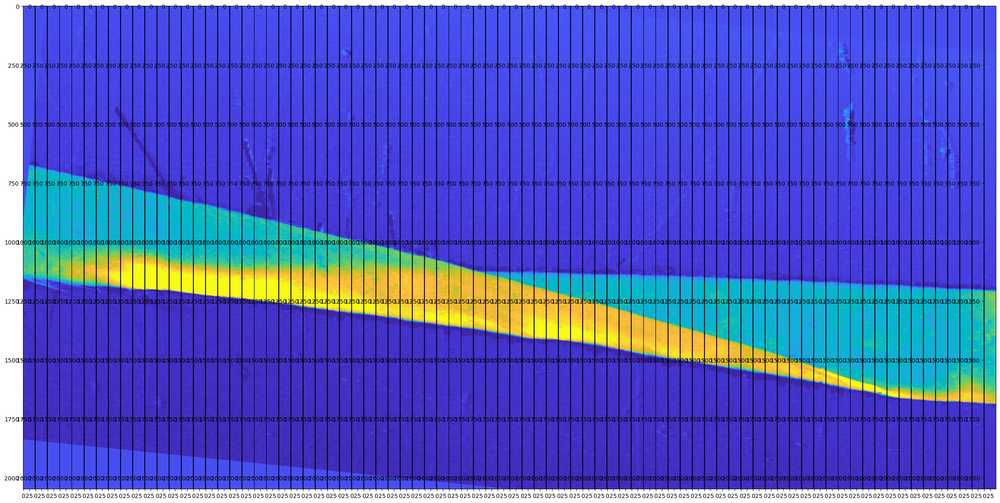

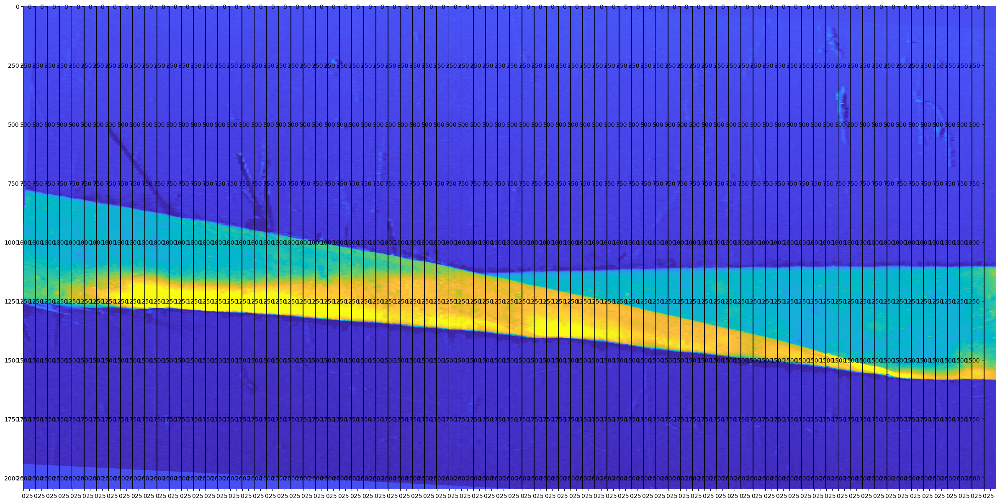

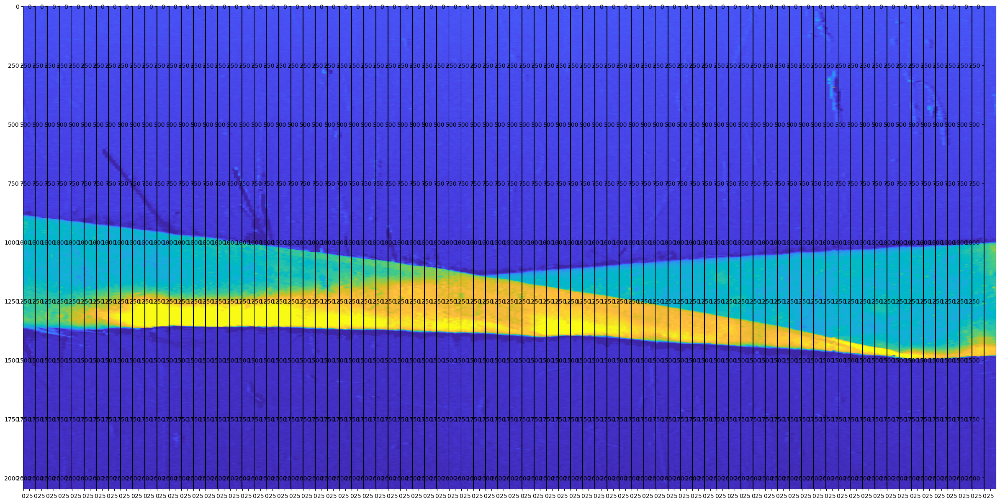

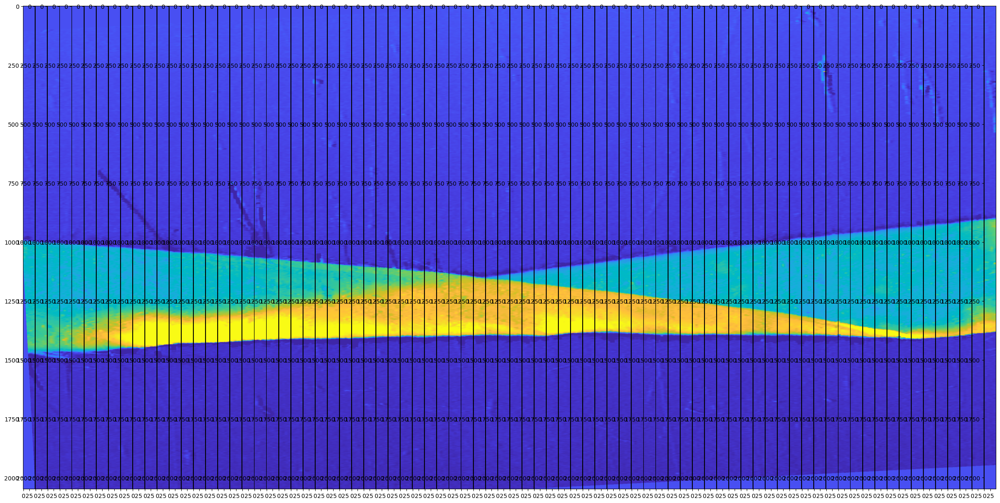

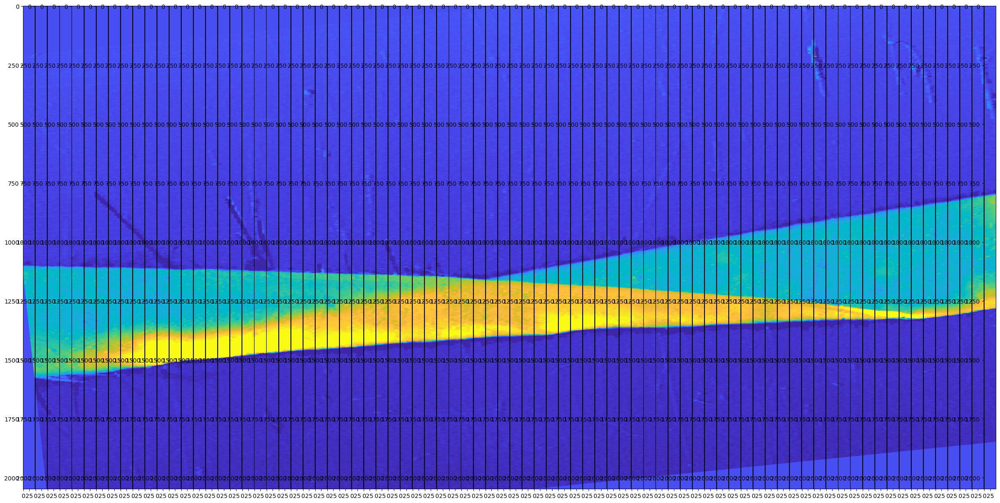

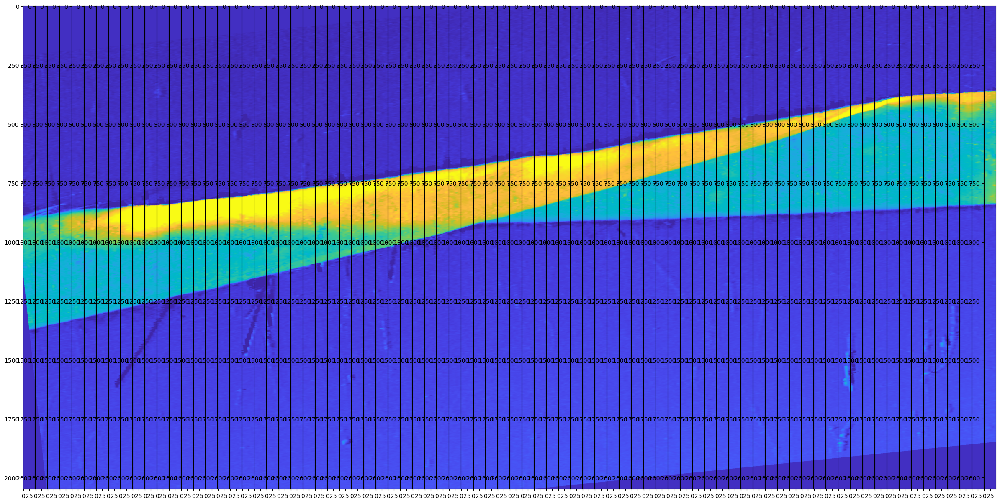

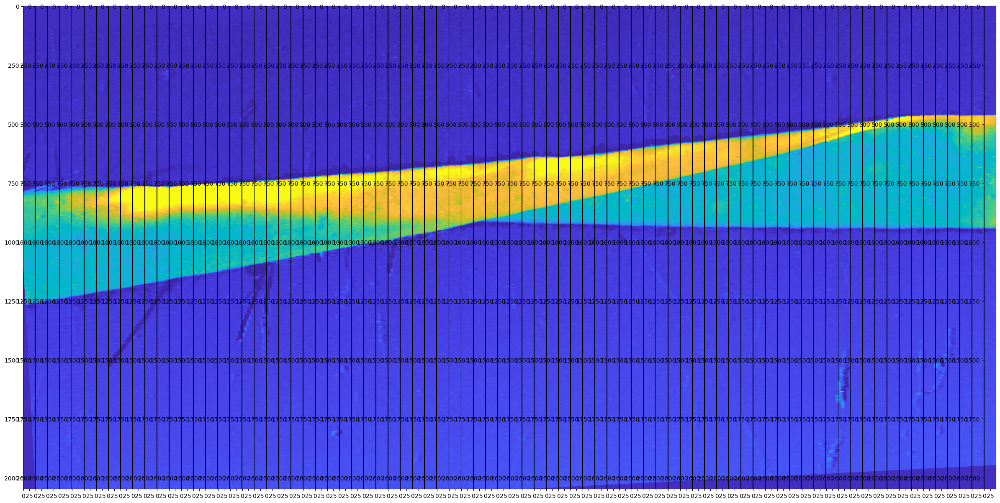

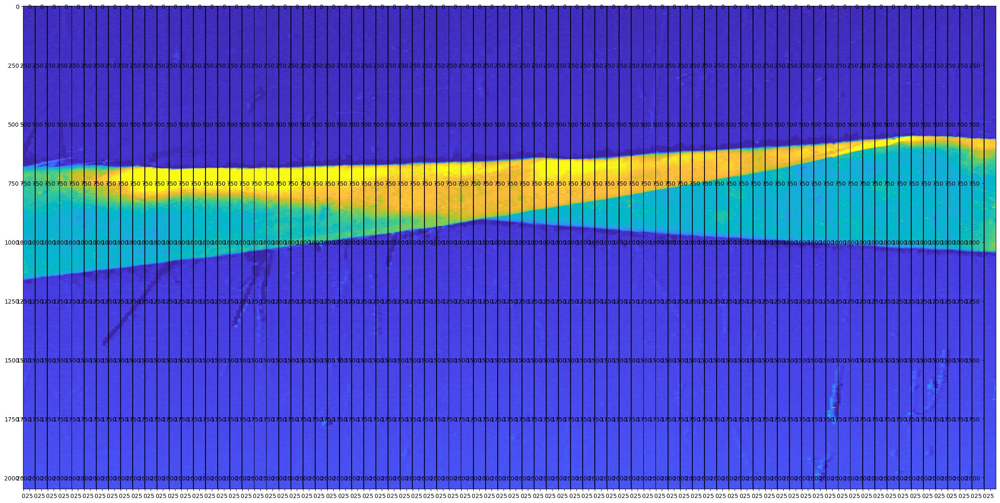

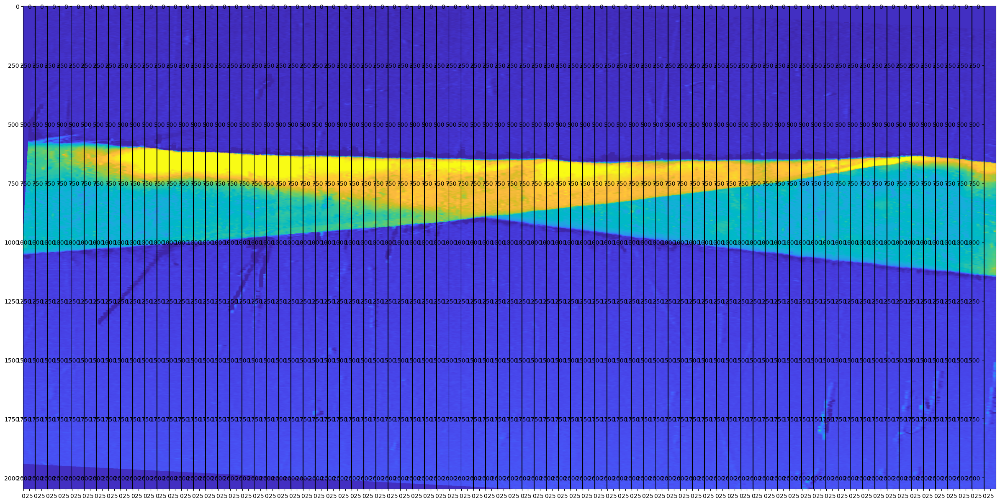

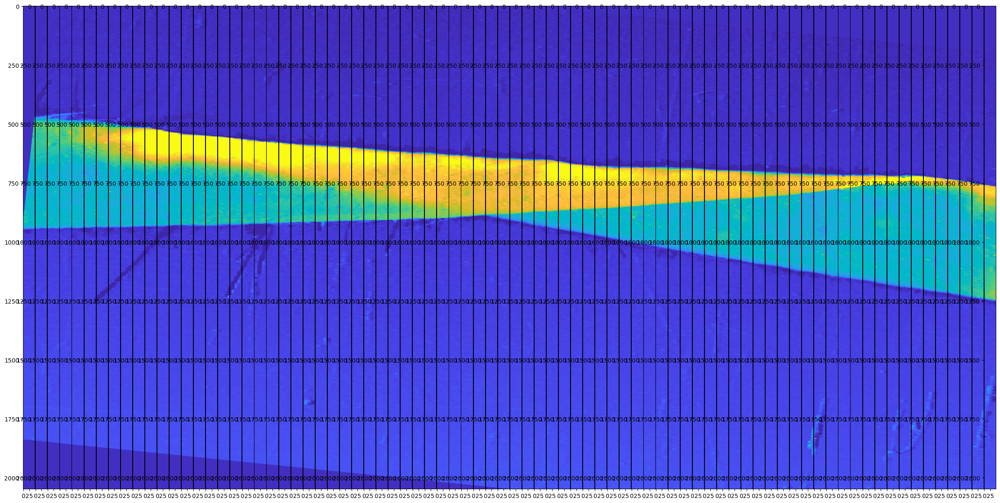

In [11]:
#check data if needed
#check rotations

image_start = 50
image_end = 60

#reshape from
#[frames,height,width,channels]
#to
#[image,frames,height,width,channels]
data_shape = frames_data.shape
print(f'Current data shape: {data_shape}')
#number of images
if ifFlip:
    img_nmb = len(image_list)*len(angle_list)*2
else:
    img_nmb = len(image_list)*len(angle_list)
new_data_shape = (img_nmb, data_shape[0]//img_nmb,data_shape[1],data_shape[2],data_shape[3])
print(f'New data shape: {new_data_shape}')

#plot frames to check reshaping
for image in frames_data.reshape(new_data_shape)[image_start:image_end]:
    numb_col = new_data_shape[1]               
    fig, axes = plt.subplots(1,numb_col, figsize=(30,15))
    fig.subplots_adjust(hspace=0.2, wspace=0)
    linewidth = 3.0
    fontsize_sec = 12
    for i,frame in enumerate(image):
        ax = axes[i]
        ax.imshow(frame)